In [1]:
import os
from PIL import Image
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import backend as K

from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

In [2]:
data_directory = r'/Users/apple/Downloads/PCB_DATASET'
def list_all_files_from_oswalkpath(oswalkpath, folders = False):
    oswalkobject = list(os.walk(oswalkpath))
    directorypath = oswalkobject[0][0]
    if folders == False:
        filenames = oswalkobject[0][2]
    elif folders == True:
        filenames = oswalkobject[0][1]
        
    return [os.path.join(directorypath,i) for i in filenames]

In [9]:
pcb_images_filepaths = list_all_files_from_oswalkpath(os.path.join(data_directory, 'PCB_USED'), folders=False)

In [12]:
images_directories_paths = list_all_files_from_oswalkpath(os.path.join(data_directory, 'images'), folders=True)

In [21]:
mousebite_images_filepaths = list_all_files_from_oswalkpath(images_directories_paths[0], folders=False)

In [51]:
pcb_images_filepaths[0]

'/Users/apple/Downloads/PCB_DATASET/PCB_USED/01.JPG'

In [28]:
baseimagepath

'/Users/apple/Downloads/PCB_DATASET/PCB_USED/01.JPG'

In [57]:
os.getcwd()

'/Users/apple/Documents/GitHub/U-Net-code'

In [62]:
os.makedirs(os.path.join(os.getcwd(),'masks'), exist_ok=True)
for i in images_directories_paths:
    os.makedirs(os.path.join(os.getcwd(),'masks',os.path.basename(i)), exist_ok=True)

In [ ]:
os.makedirs(os.path.join(os.getcwd(),'masks'), exist_ok=True)
for single_directory_path in images_directories_paths:
    foldername = os.path.basename(single_directory_path)
    os.makedirs(os.path.join(os.getcwd(),'masks',foldername), exist_ok=True)

    single_type_images_filepaths = list_all_files_from_oswalkpath(single_directory_path, folders=False)
    for imagepath in single_type_images_filepaths:
        baseimagepath = [i for i in pcb_images_filepaths if np.prod(Image.open(i).size)==np.prod(Image.open(imagepath).size)][0]
        k = (np.array(Image.open(baseimagepath).convert('L'),int)-np.array(Image.open(imagepath).convert('L'),int))
        threshold = 15
        k[k>threshold] = 255
        k[k<=threshold] = 0
        if baseimagepath==pcb_images_filepaths[0]:
            k[:20,:] = 0
        

        filename = os.path.basename(imagepath)
        mask = Image.fromarray(np.uint8(k))
        mask.save(os.path.join(os.getcwd(),'masks',foldername,filename))
        

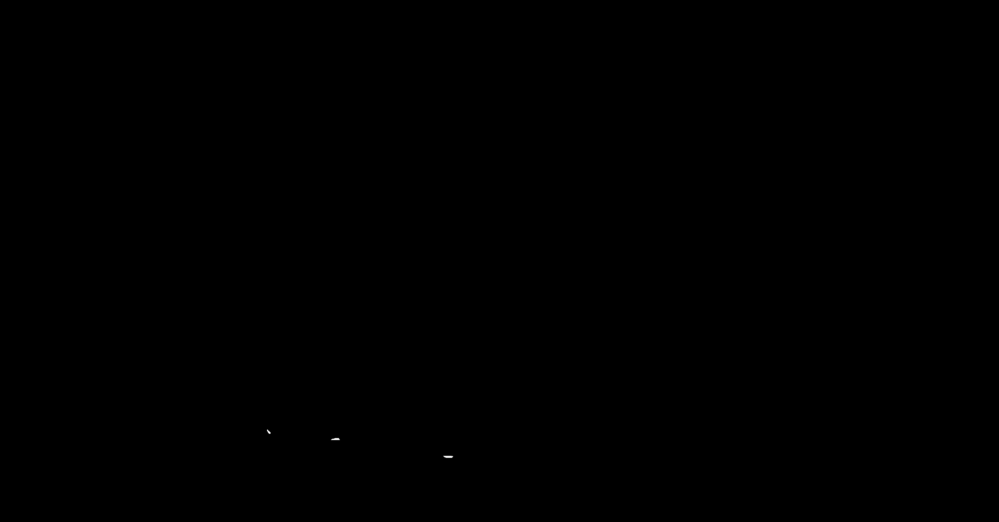

In [48]:
Image.fromarray(np.uint8(k))

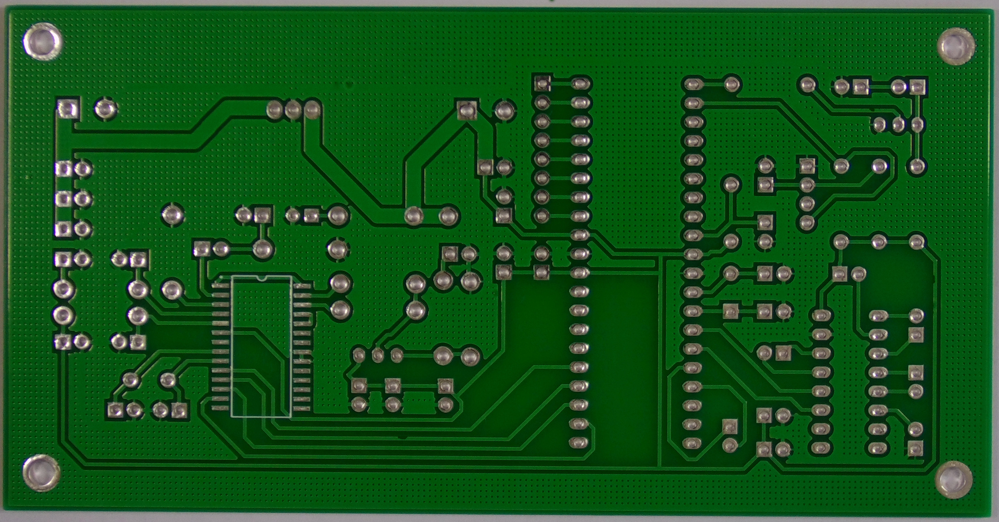

In [37]:
Image.open(collect[-5])

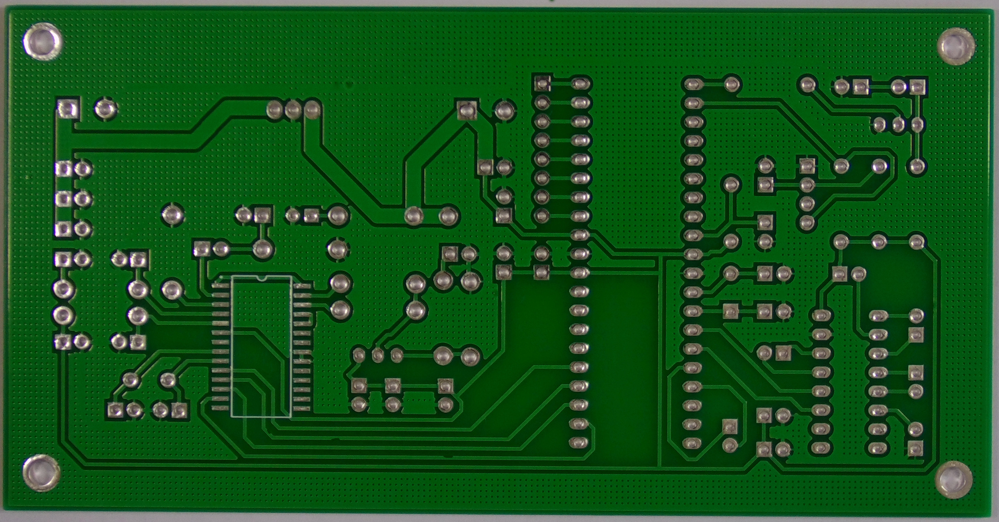

In [26]:
Image.open(imagepath)

In [ ]:
data_directory = r'/Users/apple/Downloads/dataset'
images_directory = os.path.join(data_directory, r'images')
masks_directory = os.path.join(data_directory, r'masks')